In [1]:
import pandas as pd
import numpy as np
import os
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (12,12)

In [2]:
# def crop(img, ax0_min, ax0_max, ax1_min, ax1_max):
#     ax0_size = ax0_max - ax0_min
#     ax1_size = ax1_max - ax1_min
#     ax0_start = int(max(0, ax0_min - ax0_size*2))
#     ax1_start = int(max(0, ax1_min - ax1_size*2))
#     cropped = img[ax0_start: ax0_start + ax0_size *
#                   5, ax1_start: ax1_start + ax1_size*5]

In [3]:
filename = '../csv_detection_info/1, artrose og-eller sklerose.csv'
filename_clean = '../csv_detection_info_clean/1, artrose og-eller sklerose.csv'
saved_cropped_image = '//nmbu.no/LargeFile/Project/CubiAI/preprocess/cropped/1, artrose og-eller sklerose'

In [4]:
detection_df = pd.read_csv(filename)

In [14]:
detection_df

,base_path,filename,ax0_min,ax0_max,ax1_min,ax1_max,confidence,diagnosis,diagnosis_raw
0,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,511,684,1561,1735,0.981587,1,"1, artrose og-eller sklerose"
1,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,1326,1551,1761,1986,0.892366,1,"1, artrose og-eller sklerose"
2,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.87002833.10.0.0.61.57184...,1099,1296,1532,1729,0.995004,1,"1, artrose og-eller sklerose"
3,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.1054539791.10.0.0.104.59...,880,1087,1190,1398,0.999220,1,"1, artrose og-eller sklerose"
4,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.1054539791.10.0.0.104.59...,706,915,1349,1558,0.999622,1,"1, artrose og-eller sklerose"
...,...,...,...,...,...,...,...,...,...
1044,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.3.51.0.7.14260080298.5469.18762.48078.55352....,834,990,792,948,0.999999,1,"1, artrose og-eller sklerose"
1045,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,172.177.1126.1225.1148.1223.20191128150716.32.dcm,0,0,0,0,0.000000,1,"1, artrose og-eller sklerose"
1046,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,1613,1743,1837,1967,0.778734,1,"1, artrose og-eller sklerose"
1047,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,1741,1871,1777,1906,0.352781,1,"1, artrose og-eller sklerose"


### [Optional] Sort by confidence (filter out bad prediction)

In [6]:
# detection_df = detection_df[detection_df.confidence > 0.5]

In [6]:
detection_df[detection_df.confidence < 0.5].index

Int64Index([   9,   70,   75,   76,  121,  207,  251,  253,  304,  332,  333,
             380,  399,  400,  401,  402,  481,  484,  492,  546,  560,  569,
             577,  599,  601,  954, 1022, 1045, 1047],
           dtype='int64')

Note that there is one case that is not good

### Look at the crop images

Are they reasonable, if not, mark the "weird", "wrong detected" image indice before saving it back to the clean folder

In [8]:
# plot every 9 of them

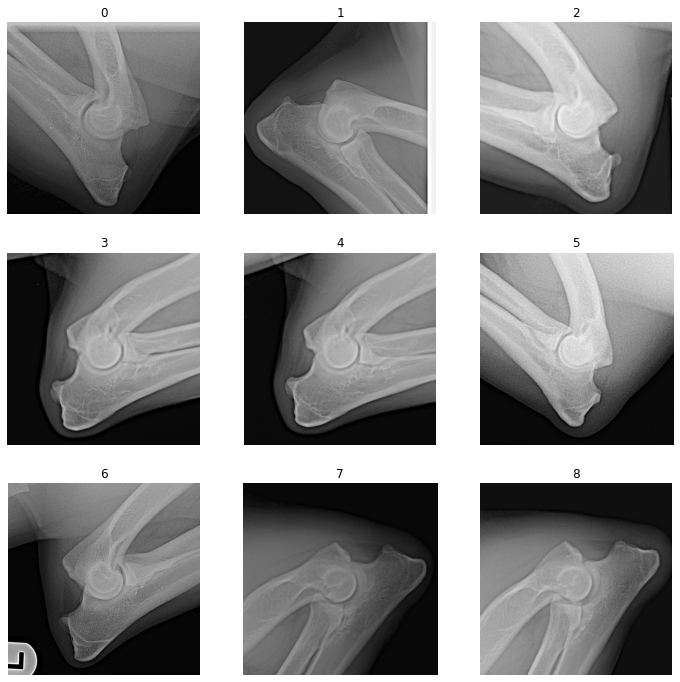

C:\NMBU\TEMP\ipykernel_12032\89006417.py:5: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(img, 'gray')
C:\NMBU\TEMP\ipykernel_12032\89006417.py:5: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(img, 'gray')


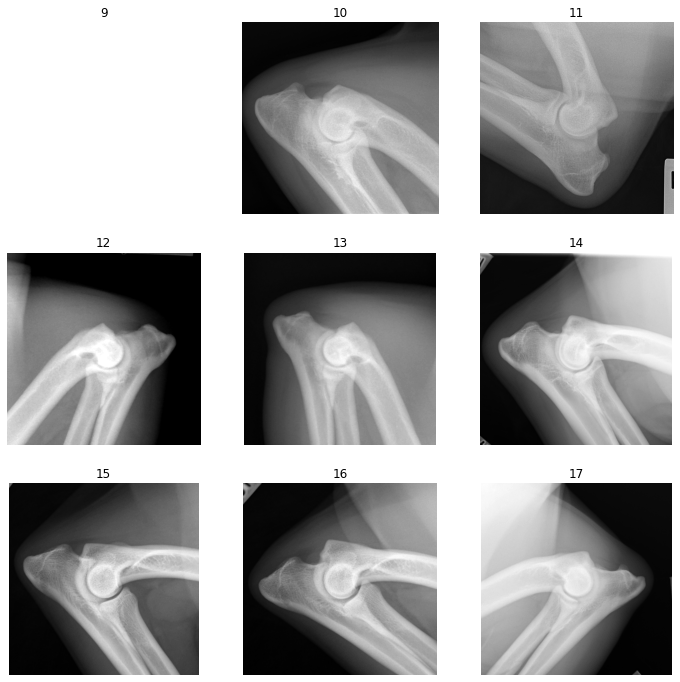

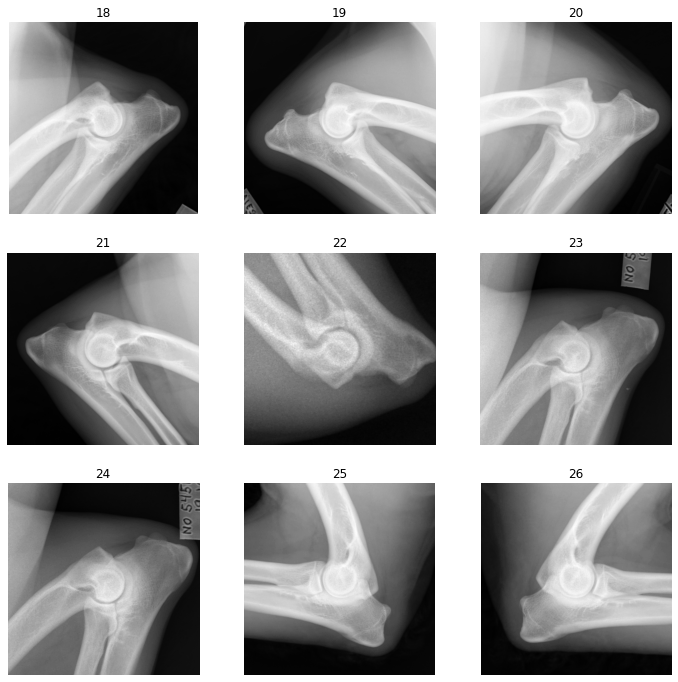

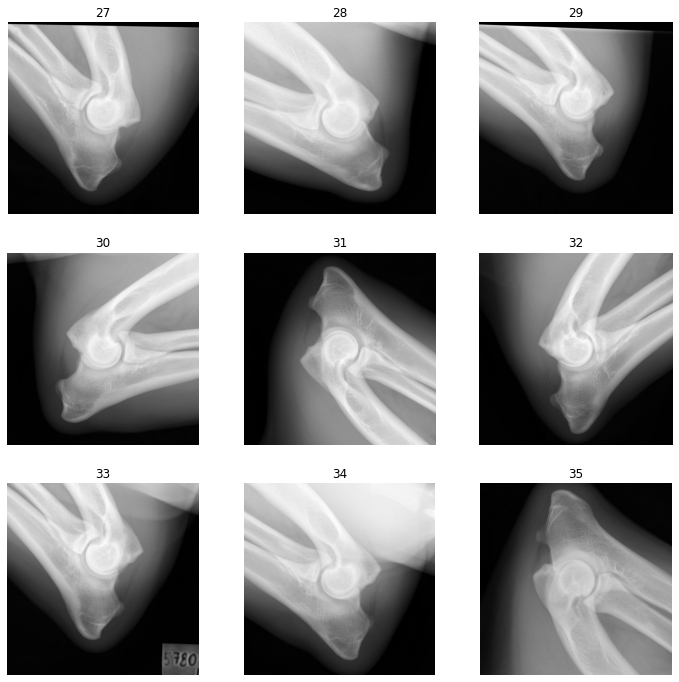

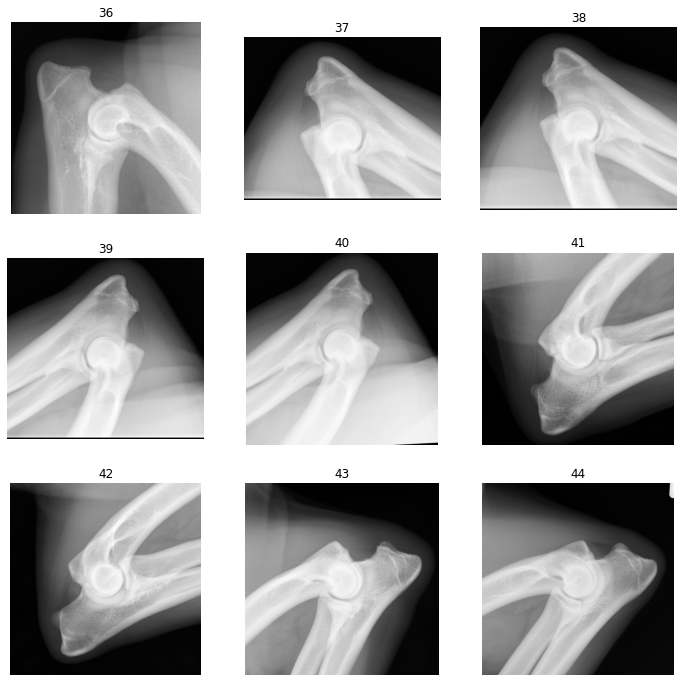

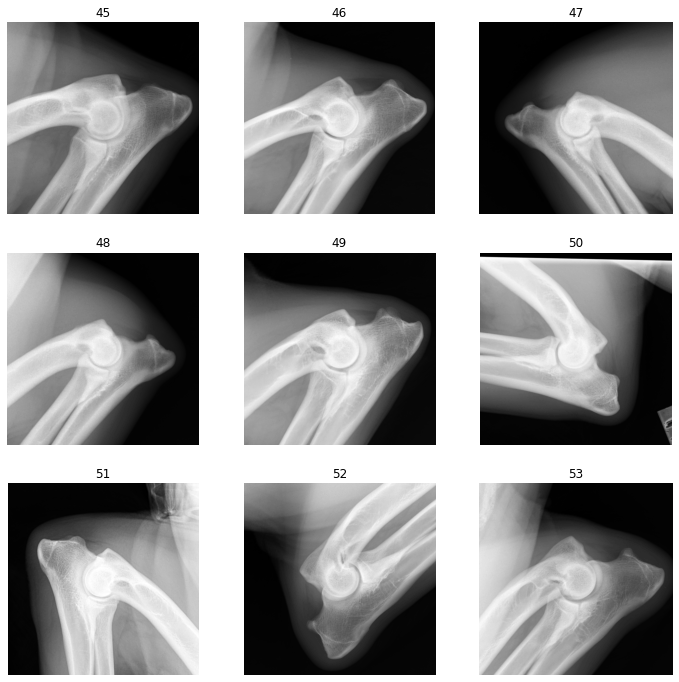

...

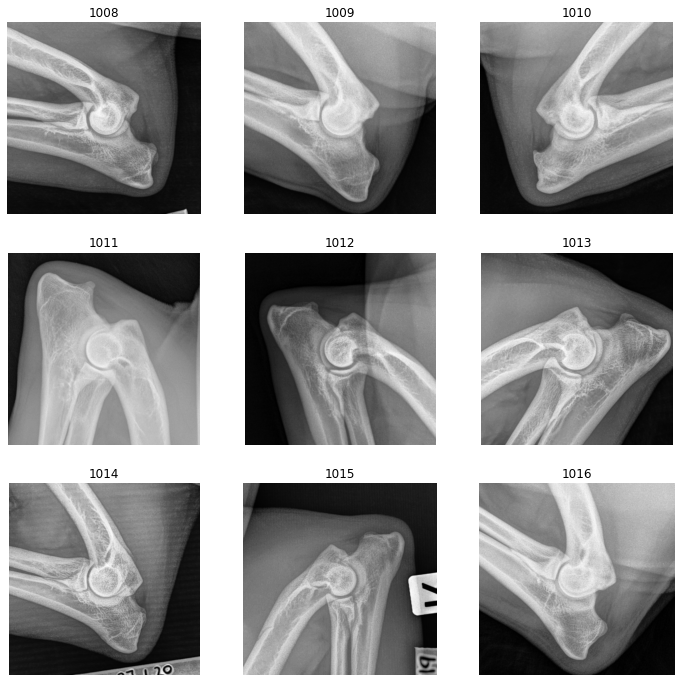

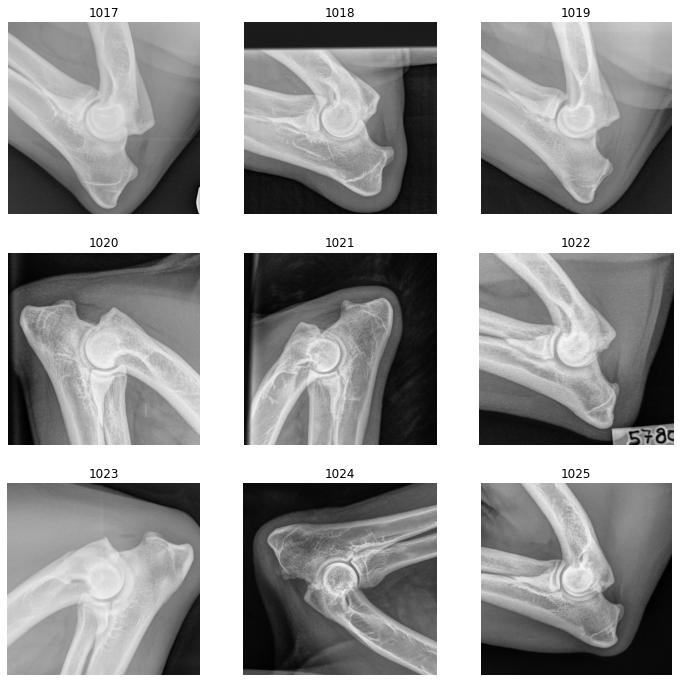

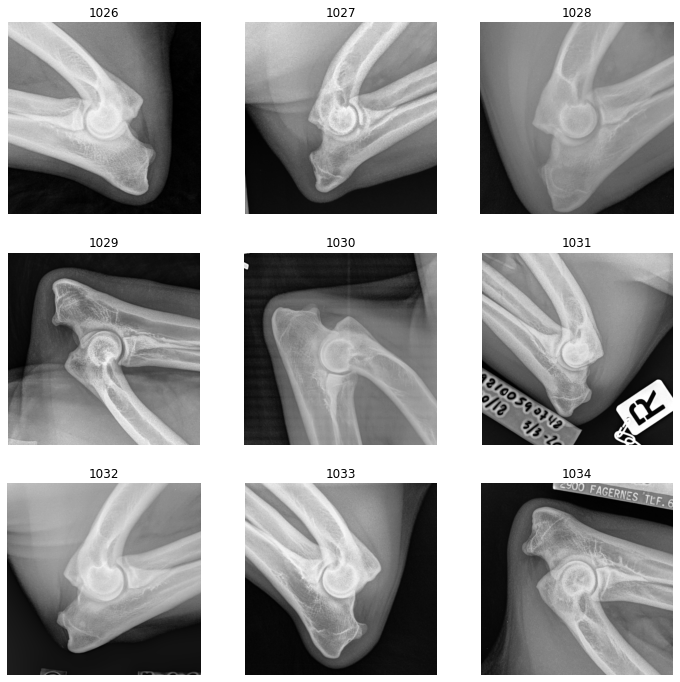

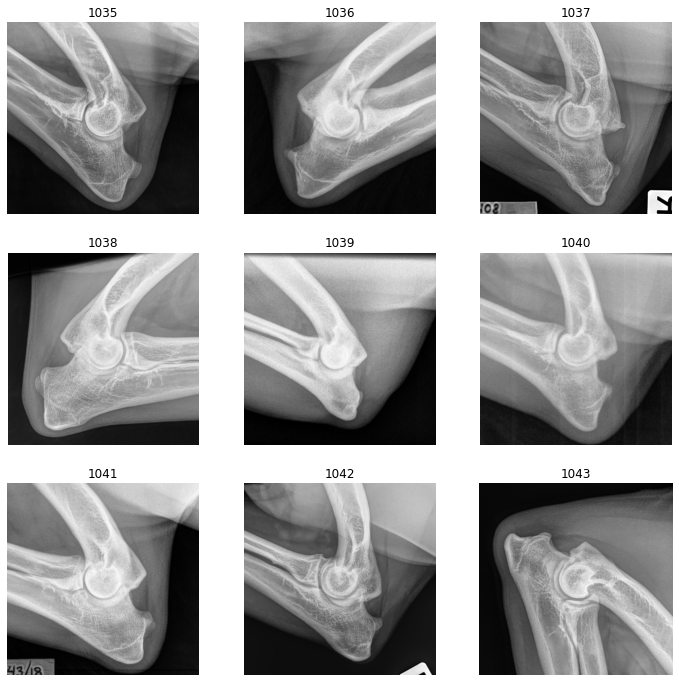

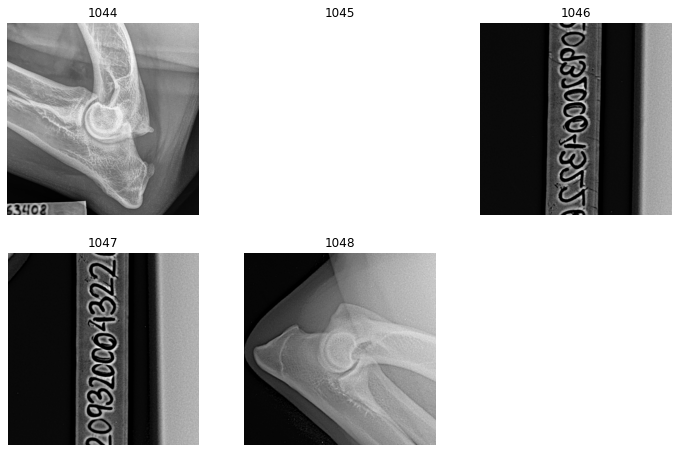

In [7]:
for id, item in detection_df.iterrows():
    fn = item['filename']
    img = np.load(saved_cropped_image + '/' + fn + '.npy')
    plt.subplot(3,3, (id%9) + 1)
    plt.imshow(img, 'gray')
    plt.axis('off')
    plt.title(str(id))
    
    if (id%9) == 8:
        plt.show()
        
plt.show()

## Remove bad detection items

In [8]:
remove_indice = [   9,   70,   75,   76,  121,  253,  332,  333,
             380,  399,  400,  401,  402,  492,  546,  569,
             577, 601,  838, 1045, 1046, 1047]
detection_df[~detection_df.index.isin(remove_indice)]

,base_path,filename,ax0_min,ax0_max,ax1_min,ax1_max,confidence,diagnosis,diagnosis_raw
0,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,511,684,1561,1735,0.981587,1,"1, artrose og-eller sklerose"
1,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1314.669053978.192.168.20.208...,1326,1551,1761,1986,0.892366,1,"1, artrose og-eller sklerose"
2,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.87002833.10.0.0.61.57184...,1099,1296,1532,1729,0.995004,1,"1, artrose og-eller sklerose"
3,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.1054539791.10.0.0.104.59...,880,1087,1190,1398,0.999220,1,"1, artrose og-eller sklerose"
4,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.1054539791.10.0.0.104.59...,706,915,1349,1558,0.999622,1,"1, artrose og-eller sklerose"
...,...,...,...,...,...,...,...,...,...
1041,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.3.51.0.7.14113378634.45258.12870.48043.20172...,459,661,1060,1262,0.999796,1,"1, artrose og-eller sklerose"
1042,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.3.51.0.7.14116573830.19298.48710.40160.46287...,458,609,740,891,0.999999,1,"1, artrose og-eller sklerose"
1043,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.3.51.0.7.14234831466.11523.11586.37158.3783....,1291,1440,1152,1302,1.000000,1,"1, artrose og-eller sklerose"
1044,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.3.51.0.7.14260080298.5469.18762.48078.55352....,834,990,792,948,0.999999,1,"1, artrose og-eller sklerose"


In [9]:
new_detection_df = detection_df[~detection_df.index.isin(remove_indice)]

In [10]:
new_detection_df.to_csv(filename_clean, index=False)